In [ ]:
import pathlib
import cv2

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
pic_path=pathlib.Path('/content/drive/MyDrive/expression')

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from glob import glob
import tensorflow as tf
from tensorflow.keras.layers import Flatten,Dense,Conv2D,MaxPool2D
from tensorflow.keras.losses import sparse_categorical_crossentropy
from tensorflow.keras.optimizers import Adam

In [ ]:
angry_data = list(pic_path.glob('angry/*'))
happy_data = list(pic_path.glob('happy/*'))
sad_data = list(pic_path.glob('sad/*'))

In [ ]:
all_data = angry_data + happy_data + sad_data
labels = [0] * len(angry_data) + [1] * len(happy_data) + [2] * len(sad_data)

In [ ]:
from sklearn.model_selection import train_test_split
xtrain, xtest, ytrain, ytest = train_test_split(all_data, labels, test_size=0.2, random_state=42)

In [ ]:
len(xtrain),len(xtest),len(ytrain),len(ytest)

(13917, 3480, 13917, 3480)

In [ ]:
import pathlib
import cv2
import numpy as np
from glob import glob

def load_and_preprocess(image_paths):
    images = []
    for path in image_paths:
        # Ensure path is a string
        path_str = str(path)

        # Load image using cv2
        img = cv2.imread(path_str, cv2.IMREAD_GRAYSCALE)

        # Check if image was loaded successfully
        if img is not None:
            # Resize to (28, 28) to match model input shape
            img = cv2.resize(img, (28, 28))
            # Normalize pixel values to the range [0, 1]
            img = img / 255.0
            # Add to list of images
            images.append(img)
        else:
            print(f"Error loading image: {path_str}") # Print

In [ ]:
xtrain[0]

PosixPath('/content/drive/MyDrive/expression/happy/_0_8669.png')

In [ ]:
xtest[0]

PosixPath('/content/drive/MyDrive/expression/angry/_0_2289.png')

In [ ]:
from tensorflow.keras import Sequential
model1=Sequential()

model1.add(Conv2D(filters=50,kernel_size=(3,3),input_shape=(28,28,1),activation="relu",padding="valid",strides=1))
model1.add(MaxPool2D(pool_size=(2,2)))
model1.add(Conv2D(filters=100,kernel_size=(3,3),activation="relu",padding="valid",strides=1))
model1.add(Conv2D(filters=100,kernel_size=(3,3),activation="relu",padding="valid",strides=1))
model1.add(MaxPool2D(pool_size=(2,2)))
model1.add(Flatten())
model1.add(Dense(100,activation="relu"))
model1.add(Dense(80,activation="relu"))
model1.add(Dense(10,activation="softmax"))
model1.summary()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 26, 26, 50)     │           500 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 13, 13, 50)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 11, 11, 100)    │        45,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 9, 9, 100)      │        90,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 4, 4, 100)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 1600)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 100)            │       160,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 80)             │         8,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 10)             │           810 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 304,690 (1.16 MB)

 Trainable params: 304,690 (1.16 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
from tensorflow.keras.losses import sparse_categorical_crossentropy, SparseCategoricalCrossentropy
model1.compile(optimizer=Adam(),loss=SparseCategoricalCrossentropy(),metrics=["accuracy"])

In [ ]:
import numpy as np
import cv2
import pathlib

# Assuming xtrain and ytrain are your data and labels (which are currently file paths)
# xtrain = np.array(xtrain) # These are still file paths, so converting to numpy array here is not the issue
# ytrain = np.array(ytrain) # These are labels, which are fine as is
# xtest = np.array(xtest)   # These are still file paths
# ytest = np.array(ytest)   # These are labels, which are fine as is

# Load and preprocess the images for the training and testing sets
# Call the load_and_preprocess function for both xtrain and xtest
xtrain_processed = load_and_preprocess(xtrain)
xtest_processed = load_and_preprocess(xtest)

# Convert the lists of processed images to NumPy arrays
xtrain = np.array(xtrain_processed)
xtest = np.array(xtest_processed)

# Now the arrays should contain image data.
# Reshape xtrain and xtest to match the model's input shape
# The -1 automatically calculates the batch size based on the total number of elements
xtrain = xtrain.reshape(-1, 28, 28, 1)
xtest = xtest.reshape(-1, 28, 28, 1)

# Ensure ytrain and ytest are also numpy arrays (they should be already from previous steps)
ytrain = np.array(ytrain)
ytest = np.array(ytest)

# Now try fitting the model again:
History = model1.fit(xtrain, ytrain, epochs=30, validation_data=(xtest, ytest), batch_size=500)

In [ ]:
model1.save("emotion.h5")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


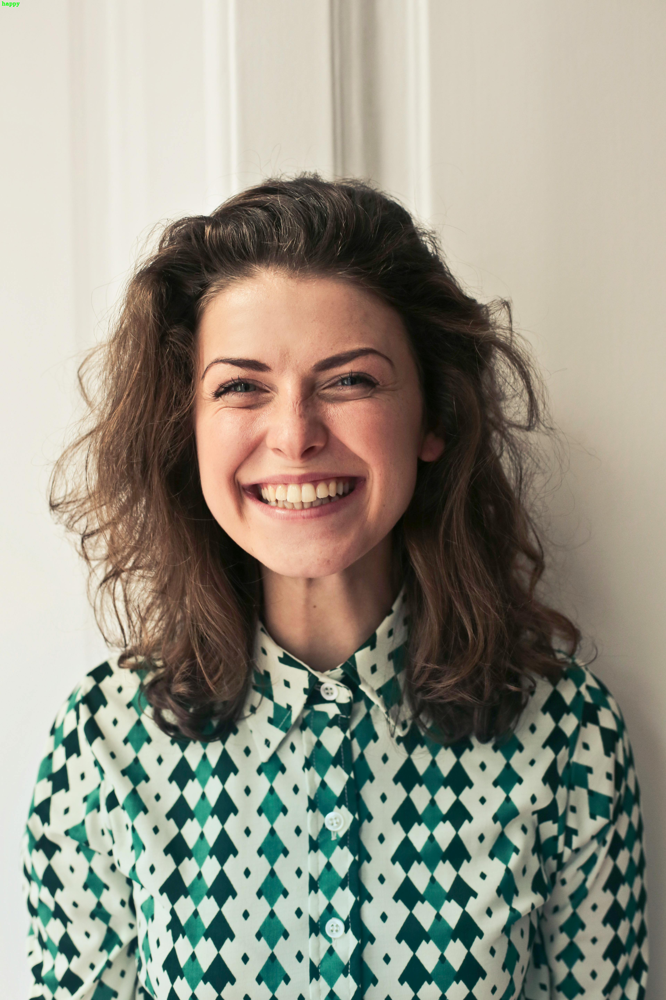

In [ ]:
import cv2
import tensorflow as tf
from google.colab.patches import cv2_imshow
import numpy as np

model = tf.keras.models.load_model('emotion.h5')
labels = {0: 'sad', 1: 'happy', 2: "angry"}  # Assuming 'angry' label should be 2

def detect_faces(frame):
  gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY) # Convert to grayscale
  resized_frame = cv2.resize(gray_frame, (28, 28)) # Resize to match training data
  resized_frame = np.expand_dims(resized_frame, axis=0) # Add batch dimension
  resized_frame = resized_frame / 255.0 # Normalize pixel values
  resized_frame = resized_frame.reshape(-1, 28, 28, 1) # Reshape to match input shape
  pred = model.predict(resized_frame)
  label = labels[pred.argmax()]
  cv2.putText(frame, label, (10, 30), cv2.FONT_HERSHEY_COMPLEX, 1, (0, 255, 0), 2, cv2.LINE_AA)
  return frame

face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
image_path = '/content/pexels-olly-774909.jpg'  # Update with the correct path and format
frame = cv2.imread(image_path)

# Check if image was loaded successfully
if frame is None:
  print(f"Error: Could not load image from {image_path}. Please check the path and format.")
  exit()

output_image = detect_faces(frame)
cv2_imshow(output_image)
cv2.waitKey(0)
cv2.destroyAllWindows()